# Shift-VAE: Application to 1D spectra with arbitrary offset in peak position

Prepared by Maxim Ziatdinov


---

This notebook denonstrates how to use shift-VAE to disentangle the representations of a 1D spectral data set, ignoring relative positions of the peaks.

---



E-mail: ziatdinovmax@gmail.com

Install pyroVED package:

In [ ]:
# Install the latest version from source
# (or you may instal a stable version from PyPi instead with !pip install pyroved)
!pip install -q git+https://github.com/ziatdinovmax/pyroved.git

  Preparing metadata (setup.py) ... done


In [ ]:
import os
import math
import numpy as np
import seaborn as sns
import pandas as pd
import time
import random

import torch

from torch.nn import Conv1d, ConvTranspose1d
from torch.nn import Linear as Lin, ReLU, Sigmoid, ConstantPad1d
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import StratifiedKFold

from matplotlib import pyplot as plt
from tqdm import tqdm

In [ ]:
import pyroved as pv
import torch
import matplotlib.pyplot as plt

First, we prepare our synthetic data representing 1D Gaussian signals with different widths that is randomly shifted along the *x*-axis and is corrupted by noise. In other words, in this example we assume that the only physical factor of variation is a signal width and other forms of variations are considered to be "instrumental distortion".

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
X_train = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_X_train.npy")
Y_train = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_Y_train.npy")

X_val = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_X_val.npy")
Y_val = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_Y_val.npy")

X_test = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_X_test.npy")
Y_test = np.load("/content/drive/MyDrive/Aerosols_Proj/Lab_Y_test.npy")

In [ ]:
X_train.shape

(140082, 400, 4)

In [ ]:
Y_train.shape

(140082,)

[ 0.25009294  0.0297816   0.00909993 -0.88946716]
[0.01682156 0.10009927 0.16545334 0.00182776]
[0.01545849 0.22584381 0.28375248 0.01468401]
[ 0.26902107  0.0049636  -0.04549967  0.11294919]
[ 0.02351301  0.13236267  0.22336201 -0.0027881 ]


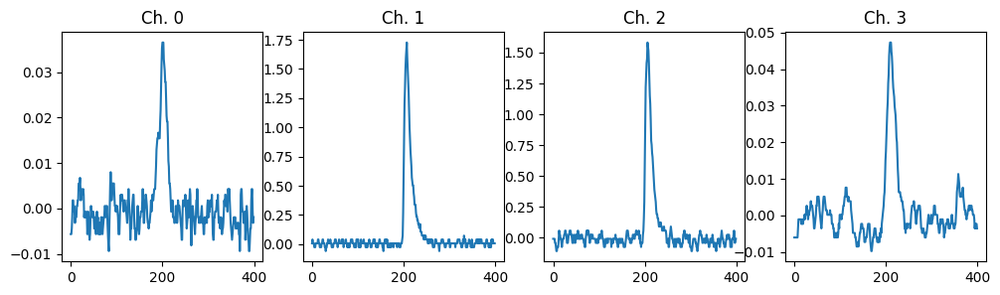

In [ ]:
n = random.randint(1, 140081)
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(12,3))
axes[0].plot(X_train[n,:,0])
axes[0].set_title("Ch. 0")
axes[1].plot(X_train[n,:,1])
axes[1].set_title("Ch. 1")
axes[2].plot(X_train[n,:,2])
axes[2].set_title("Ch. 2")
axes[3].plot(X_train[n,:,3])
axes[3].set_title("Ch. 3")

random_indices = [random.randint(0, 140081) for _ in range(5)]

for idx in random_indices:
    print(X_train[idx, 199, :])

#print out the channel 0, 1, 2, 3, 4 for one random aerosol sample in X_train.
#this will be acorss a 400 point time series


In [ ]:
Y_train.shape

(140082,)

In [ ]:
#APPLY INCANDESCENT THRESHOLD

mask = np.any(X_train[:, :, 1] > 0.2, axis=1)
X_train = X_train[mask]
Y_train = Y_train[mask]

In [ ]:
X_train.shape

(85832, 400, 4)

In [ ]:
Y_train.shape

(85832,)

In [ ]:
original_max_X_train = np.zeros((len(X_train), 4))
for p_idx in range(len(X_train)):
  for c_idx in range(4):
    original_max_X_train[p_idx][c_idx] = np.max(X_train[p_idx, :, c_idx])


In [ ]:
X_train.shape

(85832, 400, 4)

In [ ]:
peak_height = np.max(X_train[:, :, 1])
print(peak_height)

132.61664460622106


In [ ]:
#SATURATION NUMERIC

#creating a more accurate delta eps values.

# Specify  epsilon value, like how tolerant will be to change
eps = 0.001

# Step 1: Find the maximum signal per particle in Channel 0
max_signal_channel_0 = np.max(X_train[:, :, 0], axis=1)

# Step 2: Count the number of points within epsilon of the maximum for each particle in Channel 0
# This comparison now includes the epsilon tolerance around the maximum signal
count_max_signal_channel_0 = np.sum((X_train[:, :, 0] >= (max_signal_channel_0[:, np.newaxis] - eps)) &
                                    (X_train[:, :, 0] <= (max_signal_channel_0[:, np.newaxis] + eps)), axis=1)

print(count_max_signal_channel_0/400*100)
count_max_signal_channel_0.shape

[ 0.25  0.5   0.25 ... 14.25  8.75 28.75]


(85832,)

In [ ]:
max1 = np.max(X_train[:, :, 1], axis=1)
max2 = np.max(X_train[:, :, 2], axis=1)

# Calculate the color channel ratio for all 400 points
color_channel_ratio = max2 / max1

color_channel_ratio

array([1.11002002, 1.08262394, 1.21032505, ..., 1.52508171, 1.49707908,
       1.61149563])

In [ ]:
channel_min_X_train = np.zeros((len(X_train), 4))
channel_max_X_train = np.zeros((len(X_train), 4))

# WOULD APPLY SAME LOGIC TO VALIDATION AND TEST DATASETS

for p_idx in range(len(X_train)):
  for c_idx in range(4):
    channel_min_X_train[p_idx][c_idx] = np.min(X_train[p_idx, :, c_idx])

  for c_idx in range(4):
    channel_max_X_train[p_idx][c_idx] = np.max(X_train[p_idx, :, c_idx])


for p_idx in range (0,len(X_train)):
  for c_idx in range(0, 4):
    s0 = (X_train[p_idx,:,c_idx] - channel_min_X_train[p_idx][c_idx])/(channel_max_X_train[p_idx][c_idx]- channel_min_X_train[p_idx][c_idx])
    X_train[p_idx,:,c_idx] = s0

X_train

array([[[4.01606426e-03, 2.49376559e-03, 6.71140940e-03, 2.07009858e-01],
        [4.01606426e-03, 0.00000000e+00, 4.47427293e-03, 2.07009858e-01],
        [2.67737617e-03, 0.00000000e+00, 4.47427293e-03, 2.07009858e-01],
        ...,
        [5.35475234e-03, 2.49376559e-03, 6.71140940e-03, 2.07009858e-01],
        [1.07095047e-02, 2.49376559e-03, 1.11856823e-02, 2.07009858e-01],
        [8.03212851e-03, 2.49376559e-03, 8.94854586e-03, 2.07009858e-01]],

       [[1.90476190e-01, 5.76923077e-02, 7.01754386e-02, 3.93442623e-01],
        [1.90476190e-01, 5.76923077e-02, 7.01754386e-02, 3.77049180e-01],
        [2.38095238e-01, 3.84615385e-02, 5.26315789e-02, 3.93442623e-01],
        ...,
        [1.42857143e-01, 3.84615385e-02, 5.26315789e-02, 2.95081967e-01],
        [9.52380952e-02, 3.84615385e-02, 3.50877193e-02, 2.62295082e-01],
        [7.14285714e-02, 3.84615385e-02, 3.50877193e-02, 2.62295082e-01]],

       [[4.16666667e-01, 1.33333333e-01, 1.05263158e-01, 5.55555556e-01],
        

In [ ]:
print(type(X_train))

<class 'numpy.ndarray'>


In [ ]:
X_train_C0 = torch.from_numpy(X_train[:,:, 0]).float()

train_loader_0 = pv.utils.init_dataloader(X_train_C0.unsqueeze(1), batch_size=64)

fig, axes = plt.subplots(8, 8, figsize=(8, 8), dpi=300,
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

for ax, (y,) in zip(axes.flat, train_loader_0):
    y_use = y.numpy()
    ax.plot(y_use[0, 0])

plt.savefig('high_res_figure.png', dpi=300)
plt.close(fig)

from google.colab import files
files.download('high_res_figure.png')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
X_train_C1 = torch.from_numpy(X_train[:,:, 1]).float()

train_loader_1 = pv.utils.init_dataloader(X_train_C1.unsqueeze(1), batch_size=64)

fig, axes = plt.subplots(8, 8, figsize=(8, 8), dpi=300,
                         subplot_kw={'xticks':[], 'yticks':[]},
                         gridspec_kw=dict(hspace=0.1, wspace=0.1))

for ax, (y,) in zip(axes.flat, train_loader_1):
    y_use = y.numpy()
    ax.plot(y_use[0, 0])

plt.savefig('high_res_figure_channel_1.png', dpi=300)
plt.close(fig)

from google.colab import files
files.download('high_res_figure_channel_1.png')



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Our goal is to find the real/physical descriptor of the data set in an unsupervised fashion, while ignoring (or separating) relative positions of the peaks. First, let's train a regular VAE:

In [ ]:
channel_0 = (140081, )

# Initialize vanilla VAE
# Insert the color channel ratio here?

vae = pv.models.iVAE(data_dim = (400,), latent_dim = 3, invariances=None, seed=0)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(vae)

# Train for n epochs:
for e in range(55):
    trainer.step(train_loader_0)
    trainer.print_statistics()

Epoch: 1 Training loss: 89.9135
Epoch: 2 Training loss: 81.7058
Epoch: 3 Training loss: 80.6790
Epoch: 4 Training loss: 80.2345
Epoch: 5 Training loss: 79.9557
Epoch: 6 Training loss: 79.7838
Epoch: 7 Training loss: 79.6240
Epoch: 8 Training loss: 79.5354
Epoch: 9 Training loss: 79.4353
Epoch: 10 Training loss: 79.3689
Epoch: 11 Training loss: 79.2916
Epoch: 12 Training loss: 79.2487
Epoch: 13 Training loss: 79.2058
Epoch: 14 Training loss: 79.1814
Epoch: 15 Training loss: 79.1182
Epoch: 16 Training loss: 79.1036
Epoch: 17 Training loss: 79.0514
Epoch: 18 Training loss: 79.0229
Epoch: 19 Training loss: 79.0323
Epoch: 20 Training loss: 78.9836
Epoch: 21 Training loss: 78.9862
Epoch: 22 Training loss: 78.9840
Epoch: 23 Training loss: 78.9627
Epoch: 24 Training loss: 78.8866
Epoch: 25 Training loss: 78.9298
Epoch: 26 Training loss: 78.9037
Epoch: 27 Training loss: 78.8838
Epoch: 28 Training loss: 78.8688
Epoch: 29 Training loss: 78.8974
Epoch: 30 Training loss: 78.8319
Epoch: 31 Training 

In [ ]:
channel_1 = (140081, )

# Initialize vanilla VAE
# Insert the color channel ratio here?

vae = pv.models.iVAE(data_dim = (400,), latent_dim = 3, invariances=None, seed=0)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(vae)

# Train for n epochs:
for e in range(55):
    trainer.step(train_loader_1)
    trainer.print_statistics()

Epoch: 1 Training loss: 67.2680
Epoch: 2 Training loss: 58.8765
Epoch: 3 Training loss: 58.1961
Epoch: 4 Training loss: 57.8260
Epoch: 5 Training loss: 57.6069
Epoch: 6 Training loss: 57.4468
Epoch: 7 Training loss: 57.3246
Epoch: 8 Training loss: 57.2357
Epoch: 9 Training loss: 57.1542
Epoch: 10 Training loss: 57.0913
Epoch: 11 Training loss: 57.0390
Epoch: 12 Training loss: 56.9986
Epoch: 13 Training loss: 56.9467
Epoch: 14 Training loss: 56.9191
Epoch: 15 Training loss: 56.8871
Epoch: 16 Training loss: 56.8448
Epoch: 17 Training loss: 56.8282
Epoch: 18 Training loss: 56.8110
Epoch: 19 Training loss: 56.7890
Epoch: 20 Training loss: 56.7666
Epoch: 21 Training loss: 56.7536
Epoch: 22 Training loss: 56.7319
Epoch: 23 Training loss: 56.7224
Epoch: 24 Training loss: 56.7140
Epoch: 25 Training loss: 56.7155
Epoch: 26 Training loss: 56.6992
Epoch: 27 Training loss: 56.6960
Epoch: 28 Training loss: 56.6858
Epoch: 29 Training loss: 56.6587
Epoch: 30 Training loss: 56.6666
Epoch: 31 Training 

**ANALYZING OUTLIERS + Encode the training data into the latent space:**

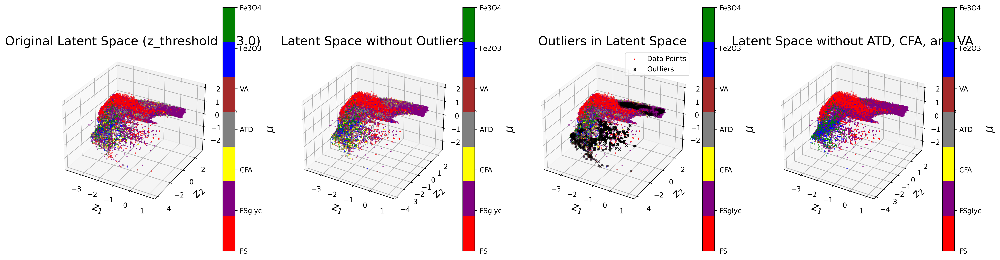

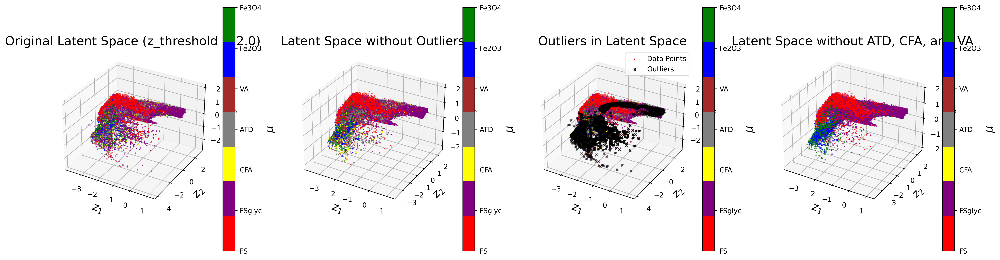

In [29]:
#3D PLOTS (NON-ADAPTIVE VERSION) --> CHANNEL 0

#ANALYZING OUTLIERS

from scipy.spatial.distance import cdist
from matplotlib.colors import ListedColormap
from mpl_toolkits.mplot3d import Axes3D  # for 3D plotting

global outlier_indices

def identify_outliers(latent_space, labels, z_threshold=3.0):
    unique_labels = np.unique(labels)
    outliers = []
    all_distances = []
    outlier_indices = []

    for label in unique_labels:
        cluster_points = latent_space[labels == label]
        centroid = cluster_points.mean(axis=0)
        distances = cdist(cluster_points, [centroid], metric='euclidean').flatten()
        all_distances.extend(distances)
        mean_distance = distances.mean()
        std_distance = distances.std()
        threshold = mean_distance + z_threshold * std_distance
        cluster_outliers = cluster_points[distances > threshold]
        outliers.append(cluster_outliers)
        outlier_indices.extend(np.where(labels == label)[0][distances > threshold])

    if outliers:
        all_outliers = np.vstack(outliers)
    else:
        all_outliers = np.array([]).reshape(0, latent_space.shape[1])

    return all_outliers, all_distances, outlier_indices

def plot_latent_space_with_threshold(z_threshold):
    outliers, all_distances, outlier_indices = identify_outliers(z_mean, Y_train, z_threshold)

    non_outlier_mask = np.ones(len(z_mean), dtype=bool)
    non_outlier_mask[outlier_indices] = False

    z_mean_filtered = z_mean[non_outlier_mask]
    Y_train_filtered = Y_train[non_outlier_mask]

    # removing atd, cfa, va
    classes_to_remove = [3, 2, 4]
    class_mask = ~np.isin(Y_train_filtered, classes_to_remove)

    z_mean_class_filtered = z_mean_filtered[class_mask]
    Y_train_class_filtered = Y_train_filtered[class_mask]

    fig = plt.figure(figsize=(24, 8), dpi=300)

    target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
    cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

    ax1 = fig.add_subplot(141, projection='3d')
    im1 = ax1.scatter(z_mean[:, -3], z_mean[:, -2], z_mean[:, -1], s=1, c=Y_train, cmap=cmap1, label='Data Points')
    ax1.set_title(f"Original Latent Space (z_threshold = {z_threshold})", fontsize=18)
    ax1.set_xlabel("$z_1$", fontsize=16)
    ax1.set_ylabel("$z_2$", fontsize=16)
    ax1.set_zlabel("$z_3$", fontsize=16)
    cbar1 = fig.colorbar(im1, ax=ax1, ticks=range(len(cmap1.colors)), shrink=.8)
    cbar1.set_ticklabels(target_names)
    cbar1.set_label("$\mu$", fontsize=16)

    ax2 = fig.add_subplot(142, projection='3d')
    im2 = ax2.scatter(z_mean_filtered[:, -3], z_mean_filtered[:, -2], z_mean_filtered[:, -1], s=1, c=Y_train_filtered, cmap=cmap1, label='Data Points')
    ax2.set_title("Latent Space without Outliers", fontsize=18)
    ax2.set_xlabel("$z_1$", fontsize=16)
    ax2.set_ylabel("$z_2$", fontsize=16)
    ax2.set_zlabel("$z_3$", fontsize=16)
    cbar2 = fig.colorbar(im2, ax=ax2, ticks=range(len(cmap1.colors)), shrink=.8)
    cbar2.set_ticklabels(target_names)
    cbar2.set_label("$\mu$", fontsize=16)

    ax3 = fig.add_subplot(143, projection='3d')
    im3 = ax3.scatter(z_mean[:, -3], z_mean[:, -2], z_mean[:, -1], s=1, c=Y_train, cmap=cmap1, label='Data Points')
    ax3.scatter(outliers[:, -3], outliers[:, -2], outliers[:, -1], s=10, c='black', marker='x', label='Outliers')
    ax3.set_title("Outliers in Latent Space", fontsize=18)
    ax3.set_xlabel("$z_1$", fontsize=16)
    ax3.set_ylabel("$z_2$", fontsize=16)
    ax3.set_zlabel("$z_3$", fontsize=16)
    cbar3 = fig.colorbar(im3, ax=ax3, ticks=range(len(cmap1.colors)), shrink=.8)
    cbar3.set_ticklabels(target_names)
    cbar3.set_label("$\mu$", fontsize=16)
    ax3.legend()

    ax4 = fig.add_subplot(144, projection='3d')
    im4 = ax4.scatter(z_mean_class_filtered[:, -3], z_mean_class_filtered[:, -2], z_mean_class_filtered[:, -1], s=1, c=Y_train_class_filtered, cmap=cmap1, label='Data Points')
    ax4.set_title("Latent Space without ATD, CFA, and VA", fontsize=18)
    ax4.set_xlabel("$z_1$", fontsize=16)
    ax4.set_ylabel("$z_2$", fontsize=16)
    ax4.set_zlabel("$z_3$", fontsize=16)
    cbar4 = fig.colorbar(im4, ax=ax4, ticks=range(len(cmap1.colors)), shrink=.8)
    cbar4.set_ticklabels(target_names)
    cbar4.set_label("$\mu$", fontsize=16)

    plt.show()

z_mean, z_sd = vae.encode(X_train_C0)

plot_latent_space_with_threshold(3.0)
plot_latent_space_with_threshold(2.0)


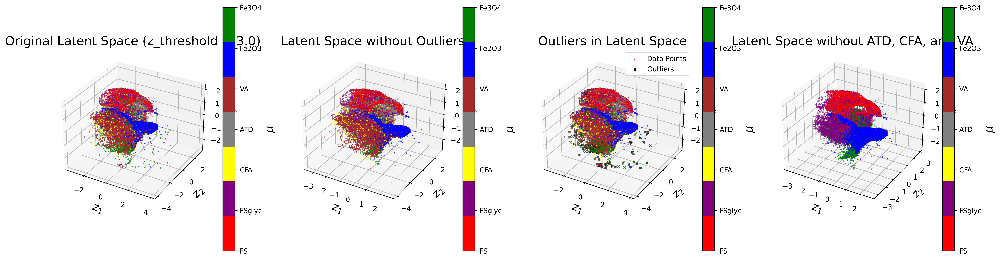

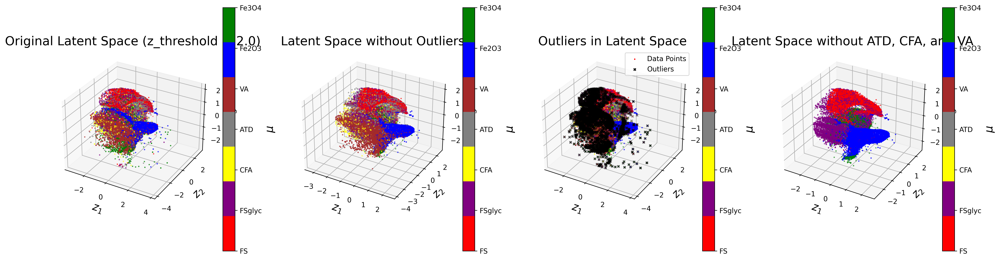

In [31]:
#3D PLOTS (NON-ADAPTATIVE VERSION) --> CHANNEL 1

from scipy.spatial.distance import cdist
from matplotlib.colors import ListedColormap
from mpl_toolkits.mplot3d import Axes3D


def identify_outliers(latent_space, labels, z_threshold=3.0):
    unique_labels = np.unique(labels)
    outliers = []
    all_distances = []
    outlier_indices = []

    for label in unique_labels:
        cluster_points = latent_space[labels == label]
        centroid = cluster_points.mean(axis=0)
        distances = cdist(cluster_points, [centroid], metric='euclidean').flatten()
        all_distances.extend(distances)
        mean_distance = distances.mean()
        std_distance = distances.std()
        threshold = mean_distance + z_threshold * std_distance
        cluster_outliers = cluster_points[distances > threshold]
        outliers.append(cluster_outliers)
        outlier_indices.extend(np.where(labels == label)[0][distances > threshold])

    if outliers:
        all_outliers = np.vstack(outliers)
    else:
        all_outliers = np.array([]).reshape(0, latent_space.shape[1])

    return all_outliers, all_distances, outlier_indices

def plot_latent_space_with_threshold(z_threshold):
    outliers, all_distances, outlier_indices = identify_outliers(z_mean_1, Y_train, z_threshold)

    non_outlier_mask = np.ones(len(z_mean_1), dtype=bool)
    non_outlier_mask[outlier_indices] = False

    z_mean_filtered = z_mean_1[non_outlier_mask]
    Y_train_filtered = Y_train[non_outlier_mask]

    # removing atd, cfa, va
    classes_to_remove = [3, 2, 4]
    class_mask = ~np.isin(Y_train_filtered, classes_to_remove)

    z_mean_class_filtered = z_mean_filtered[class_mask]
    Y_train_class_filtered = Y_train_filtered[class_mask]

    fig = plt.figure(figsize=(24, 8), dpi=300)

    target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
    cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

    ax1 = fig.add_subplot(141, projection='3d')
    im1 = ax1.scatter(z_mean_1[:, -3], z_mean_1[:, -2], z_mean_1[:, -1], s=1, c=Y_train, cmap=cmap1, label='Data Points')
    ax1.set_title(f"Original Latent Space (z_threshold = {z_threshold})", fontsize=18)
    ax1.set_xlabel("$z_1$", fontsize=16)
    ax1.set_ylabel("$z_2$", fontsize=16)
    ax1.set_zlabel("$z_3$", fontsize=16)
    cbar1 = fig.colorbar(im1, ax=ax1, ticks=range(len(cmap1.colors)), shrink=.8)
    cbar1.set_ticklabels(target_names)
    cbar1.set_label("$\mu$", fontsize=16)

    ax2 = fig.add_subplot(142, projection='3d')
    im2 = ax2.scatter(z_mean_filtered[:, -3], z_mean_filtered[:, -2], z_mean_filtered[:, -1], s=1, c=Y_train_filtered, cmap=cmap1, label='Data Points')
    ax2.set_title("Latent Space without Outliers", fontsize=18)
    ax2.set_xlabel("$z_1$", fontsize=16)
    ax2.set_ylabel("$z_2$", fontsize=16)
    ax2.set_zlabel("$z_3$", fontsize=16)
    cbar2 = fig.colorbar(im2, ax=ax2, ticks=range(len(cmap1.colors)), shrink=.8)
    cbar2.set_ticklabels(target_names)
    cbar2.set_label("$\mu$", fontsize=16)

    ax3 = fig.add_subplot(143, projection='3d')
    im3 = ax3.scatter(z_mean_1[:, -3], z_mean_1[:, -2], z_mean_1[:, -1], s=1, c=Y_train, cmap=cmap1, label='Data Points')
    ax3.scatter(outliers[:, -3], outliers[:, -2], outliers[:, -1], s=10, c='black', marker='x', label='Outliers')
    ax3.set_title("Outliers in Latent Space", fontsize=18)
    ax3.set_xlabel("$z_1$", fontsize=16)
    ax3.set_ylabel("$z_2$", fontsize=16)
    ax3.set_zlabel("$z_3$", fontsize=16)
    cbar3 = fig.colorbar(im3, ax=ax3, ticks=range(len(cmap1.colors)), shrink=.8)
    cbar3.set_ticklabels(target_names)
    cbar3.set_label("$\mu$", fontsize=16)
    ax3.legend()

    ax4 = fig.add_subplot(144, projection='3d')
    im4 = ax4.scatter(z_mean_class_filtered[:, -3], z_mean_class_filtered[:, -2], z_mean_class_filtered[:, -1], s=1, c=Y_train_class_filtered, cmap=cmap1, label='Data Points')
    ax4.set_title("Latent Space without ATD, CFA, and VA", fontsize=18)
    ax4.set_xlabel("$z_1$", fontsize=16)
    ax4.set_ylabel("$z_2$", fontsize=16)
    ax4.set_zlabel("$z_3$", fontsize=16)
    cbar4 = fig.colorbar(im4, ax=ax4, ticks=range(len(cmap1.colors)), shrink=.8)
    cbar4.set_ticklabels(target_names)
    cbar4.set_label("$\mu$", fontsize=16)

    plt.show()

z_mean_1, z_sd_1 = vae.encode(X_train_C1)

plot_latent_space_with_threshold(3.0)
plot_latent_space_with_threshold(2.0)





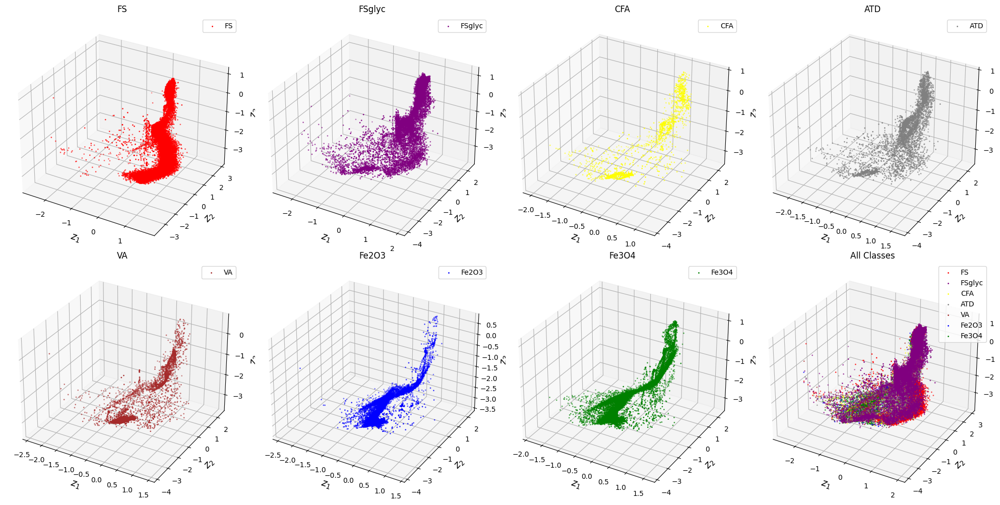

In [32]:
#CHANNEL 0, 3D, Individual Classes

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap
import numpy as np
from google.colab import files

z_mean, z_sd = vae.encode(X_train_C0)

target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

fig, axs = plt.subplots(2, 4, figsize=(20, 10), subplot_kw={'projection': '3d'})

for idx_0 in range(7):
    class_indices = np.where(Y_train == idx_0)[0]  # Ensure proper indexing
    z_mean_class = z_mean[class_indices]

    ax = axs[idx_0 // 4, idx_0 % 4]
    ax.scatter(z_mean_class[:, -1], z_mean_class[:, -2], z_mean_class[:, -3], s=1, color=cmap1(idx_0), label=target_names[idx_0])
    ax.set_xlabel("$z_1$", fontsize=14)
    ax.set_ylabel("$z_2$", fontsize=14)
    ax.set_zlabel("$z_3$", fontsize=14)
    ax.legend()
    ax.set_title(target_names[idx_0])

ax_all = axs[1, 3]
for idx_0 in range(7):
    class_indices = np.where(Y_train == idx_0)[0]
    z_mean_class = z_mean[class_indices]
    ax_all.scatter(z_mean_class[:, -1], z_mean_class[:, -2], z_mean_class[:, -3], s=1, color=cmap1(idx_0), label=target_names[idx_0])

ax_all.set_xlabel("$z_1$", fontsize=14)
ax_all.set_ylabel("$z_2$", fontsize=14)
ax_all.set_zlabel("$z_3$", fontsize=14)
ax_all.legend()
ax_all.set_title("All Classes")

plt.tight_layout()
# filename = '3D_individualAerosolClass.png'
# plt.savefig(filename, dpi=300)
plt.show()

# HIGH Resolution Download
# files.download(filename)

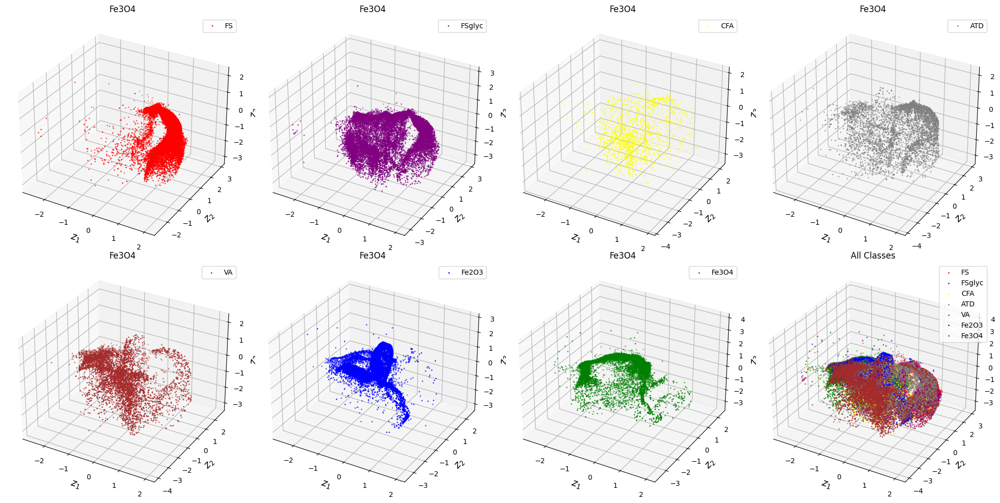

In [34]:
# CHANNEL 1, 3D, Individual Classes

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colors import ListedColormap
import numpy as np
from google.colab import files

z_mean_1, z_sd_1 = vae.encode(X_train_C1)

target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
cmap1 = ListedColormap(['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green'])

fig, axs = plt.subplots(2, 4, figsize=(20, 10), subplot_kw={'projection': '3d'})

for idx_1 in range(7):
    class_indices = np.where(Y_train == idx_1)[0]
    z_mean_class = z_mean_1[class_indices]

    ax = axs[idx_1 // 4, idx_1 % 4]
    ax.scatter(z_mean_class[:, -1], z_mean_class[:, -2], z_mean_class[:, -3], s=1, color=cmap1(idx_1), label=target_names[idx_1])
    ax.set_xlabel("$z_1$", fontsize=14)
    ax.set_ylabel("$z_2$", fontsize=14)
    ax.set_zlabel("$z_3$", fontsize=14)
    ax.legend()
    ax.set_title(target_names[idx_0])

ax_all = axs[1, 3]
for idx_1 in range(7):
    class_indices = np.where(Y_train == idx_1)[0]
    z_mean_class = z_mean_1[class_indices]
    ax_all.scatter(z_mean_class[:, -1], z_mean_class[:, -2], z_mean_class[:, -3], s=1, color=cmap1(idx_1), label=target_names[idx_1])

ax_all.set_xlabel("$z_1$", fontsize=14)
ax_all.set_ylabel("$z_2$", fontsize=14)
ax_all.set_zlabel("$z_3$", fontsize=14)
ax_all.legend()
ax_all.set_title("All Classes")

plt.tight_layout()
# filename = '3D_individualAerosolClass_channel_1.png'
# plt.savefig(filename, dpi=300)
plt.show()

# HIGH Resolution Download
# files.download(filename)

In [38]:
#3D PLOTS (PLOTLY VERSION) --> CHANNEL 0

import numpy as np
import plotly.graph_objs as go
from scipy.spatial.distance import cdist

def identify_outliers(latent_space, labels, z_threshold=3.0):
    global_centroid = latent_space.mean(axis=0)
    distances = cdist(latent_space, [global_centroid], metric='euclidean').flatten()
    mean_distance = distances.mean()
    std_distance = distances.std()
    threshold = mean_distance + z_threshold * std_distance
    outlier_indices = np.where(distances > threshold)[0]
    outliers = latent_space[outlier_indices]
    return outliers, distances, outlier_indices

def plot_latent_space_with_threshold(z_threshold):
    outliers, all_distances, outlier_indices = identify_outliers(z_mean, Y_train, z_threshold)

    non_outlier_mask = np.ones(len(z_mean), dtype=bool)
    non_outlier_mask[outlier_indices] = False

    z_mean_filtered = z_mean[non_outlier_mask]
    Y_train_filtered = Y_train[non_outlier_mask]

    classes_to_remove = [3, 2, 4]
    class_mask = ~np.isin(Y_train_filtered, classes_to_remove)

    z_mean_class_filtered = z_mean_filtered[class_mask]
    Y_train_class_filtered = Y_train_filtered[class_mask]

    target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
    colors = ['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green']

    fig = go.Figure()

    Y_train_int = Y_train.astype(int)

    fig.add_trace(go.Scatter3d(
        x=z_mean[:, -3],
        y=z_mean[:, -2],
        z=z_mean[:, -1],
        mode='markers',
        marker=dict(size=3, color=[colors[int(i)] for i in Y_train_int]),
        text=[f"Index: {i}" for i in range(len(z_mean))],  # put the data index as part of this new hover variable
        hoverinfo='text+x+y+z',
        name='Original Latent Space'
    ))

    # Add outliers with datapoint index
    fig.add_trace(go.Scatter3d(
        x=outliers[:, -3],
        y=outliers[:, -2],
        z=outliers[:, -1],
        mode='markers',
        marker=dict(size=6, color='black', symbol='x'),
        text=[f"Index: {i}" for i in outlier_indices],  # same as above
        hoverinfo='text+x+y+z',
        name='Outliers'
    ))

    fig.update_layout(scene=dict(
        xaxis_title='$z_1$',
        yaxis_title='$z_2$',
        zaxis_title='$z_3$',
    ),
    title=f'Latent Space with z_threshold={z_threshold}',
    margin=dict(l=0, r=0, b=0, t=40))

    fig.show()

# Example usage:
z_mean, z_sd = vae.encode(X_train_C0)
plot_latent_space_with_threshold(3.0)




In [37]:
#3D PLOTS (PLOTLY VERSION) --> CHANNEL 1

import numpy as np
import plotly.graph_objs as go
from scipy.spatial.distance import cdist

def identify_outliers(latent_space, labels, z_threshold=3.0):
    global_centroid = latent_space.mean(axis=0)
    distances = cdist(latent_space, [global_centroid], metric='euclidean').flatten()
    mean_distance = distances.mean()
    std_distance = distances.std()
    threshold = mean_distance + z_threshold * std_distance
    outlier_indices = np.where(distances > threshold)[0]
    outliers = latent_space[outlier_indices]
    return outliers, distances, outlier_indices

def plot_latent_space_with_threshold(z_threshold):
    outliers, all_distances, outlier_indices = identify_outliers(z_mean_1, Y_train, z_threshold)

    non_outlier_mask = np.ones(len(z_mean_1), dtype=bool)
    non_outlier_mask[outlier_indices] = False

    z_mean_filtered = z_mean_1[non_outlier_mask]
    Y_train_filtered = Y_train[non_outlier_mask]

    classes_to_remove = [3, 2, 4]
    class_mask = ~np.isin(Y_train_filtered, classes_to_remove)

    z_mean_class_filtered = z_mean_filtered[class_mask]
    Y_train_class_filtered = Y_train_filtered[class_mask]

    target_names = ["FS", "FSglyc", "CFA", "ATD", "VA", "Fe2O3", "Fe3O4"]
    colors = ['red', 'purple', 'yellow', 'gray', 'brown', 'blue', 'green']

    fig = go.Figure()

    Y_train_int = Y_train.astype(int)

    fig.add_trace(go.Scatter3d(
        x=z_mean_1[:, -3],
        y=z_mean_1[:, -2],
        z=z_mean_1[:, -1],
        mode='markers',
        marker=dict(size=3, color=[colors[int(i)] for i in Y_train_int]),
        text=[f"Index: {i}" for i in range(len(z_mean_1))],  # put the data index as part of this new hover variable
        hoverinfo='text+x+y+z',
        name='Original Latent Space'
    ))

    fig.add_trace(go.Scatter3d(
        x=outliers[:, -3],
        y=outliers[:, -2],
        z=outliers[:, -1],
        mode='markers',
        marker=dict(size=6, color='black', symbol='x'),
        text=[f"Index: {i}" for i in outlier_indices],  # same as above
        hoverinfo='text+x+y+z',
        name='Outliers'
    ))

    fig.update_layout(scene=dict(
        xaxis_title='$z_1$',
        yaxis_title='$z_2$',
        zaxis_title='$z_3$',
    ),
    title=f'Latent Space with z_threshold={z_threshold}',
    margin=dict(l=0, r=0, b=0, t=40))

    fig.show()

z_mean_1, z_sd_1 = vae.encode(X_train_C1)
plot_latent_space_with_threshold(3.0)

In [39]:
# 3D LATENT MANIFOLD

def generate_latent_grid3D(z_mean,n=10,order=[0,1,2],thirddecile=None):
    # generates a grid of latent space coordinates sampled at the deciles of the distribution
    # zmean - latent variables (# samples, # latent variables)
    # n - number of deciles in the manifold
    # order - the first two indices in the list are the latent variables we visualize, the 3rd indice is sampled at its mean value
    # thirddecile (default = 5) 50th percentile
    nlat = z_mean.shape[1]

    increment = 100//n
    start = increment//2
    nlatent = 3

    percentile_values = np.arange(start,100,increment)

    grid_z = np.zeros((nlatent,n))

    for i in range(0,nlatent):
        grid_z[i,:]=np.percentile(z_mean[:,i],percentile_values)

    z0grid = grid_z[order[0],:]
    z1grid = grid_z[order[1],:]

    if thirddecile==None:
        thirddecile = len(percentile_values)//2

    z2val = grid_z[order[2],thirddecile] # use the mean value for the 3rd latent variable

    z = []
    for xi in z0grid:
        for yi in z1grid:

            currcoords = torch.zeros(3).float()
            currcoords[order[0]] = xi
            currcoords[order[1]] = yi
            currcoords[order[2]] = z2val

            z.append(currcoords.unsqueeze(dim=0))
    return torch.cat(z), (z0grid,z1grid)

In [42]:
import torch

# sort of need to define the device based on CUDA availability
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

ndeciles = 10
z, (grid_x, grid_y) = generate_latent_grid3D(z_mean, n=ndeciles, order=[0, 1, 2])

# z goes to cpu or gpu accordingly
z = z.to(device)

# make sure model is on the same device
vae.to(device)
loc = vae.decoder([z])


In [43]:
#from pyroved.utils.viz function
# update this function to add labels, etc.
from typing import Union, List, Tuple
def plot_spect_grid(spectra: torch.Tensor, d: int, **kwargs: List[float]):  # TODO: Add 'axes' and 'extent'
    """
    Plots a *d*-by-*d* square grid with 1D spectral plots
    """
    _, axes = plt.subplots(d, d, figsize=(8, 8),
                           subplot_kw={'xticks': [], 'yticks': []},
                           gridspec_kw=dict(hspace=0.1, wspace=0.1))
    ylim = kwargs.get("ylim")
    spectra = spectra.cpu()
    for ax, y in zip(axes.flat, spectra):
        ax.plot(y.squeeze())
        if ylim:
            ax.set_ylim(*ylim)

    plt.show()

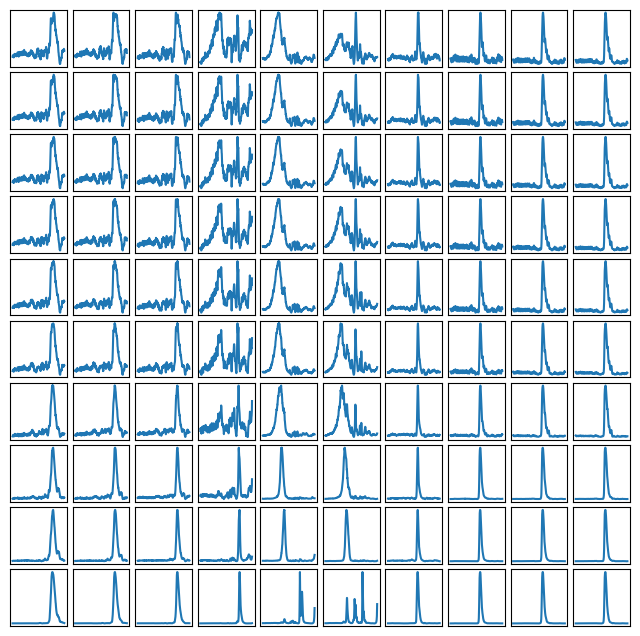

In [44]:
plot_spect_grid(loc.detach(),ndeciles)

43087


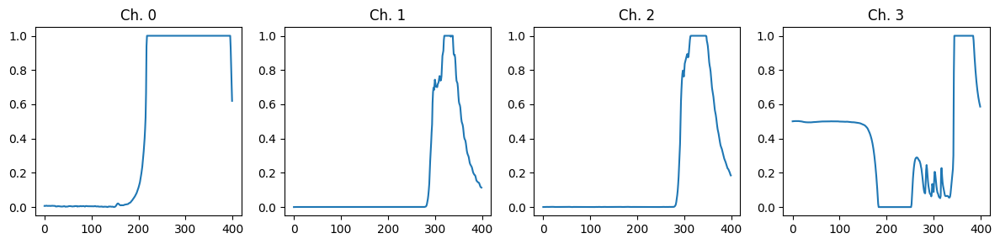

Channel values for just this selected outlier at index 43087
Channel 0 at [time] point 199: 0.10571840461316677
Channel 1 at [time] point 199: 0.0002498126405196103
Channel 2 at [time] point 199: 0.0002496255616575137
Channel 3 at [time] point 199: 0.0


In [47]:
#CHANGE Z_MEAN and Z_MEAN_1 accordingly

outliers, all_distances, outlier_indices = identify_outliers(z_mean_1, Y_train, 3.0)
random_outlier_index = random.choice(outlier_indices)
print(random_outlier_index)

fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(12, 3))
axes[0].plot(X_train[random_outlier_index, :, 0])
axes[0].set_title("Ch. 0")
axes[1].plot(X_train[random_outlier_index, :, 1])
axes[1].set_title("Ch. 1")
axes[2].plot(X_train[random_outlier_index, :, 2])
axes[2].set_title("Ch. 2")
axes[3].plot(X_train[random_outlier_index, :, 3])
axes[3].set_title("Ch. 3")

plt.tight_layout()
plt.show()

print("Channel values for just this selected outlier at index", random_outlier_index)
for ch in range(4):
    print(f"Channel {ch} at [time] point 199:", X_train[random_outlier_index, 199, ch])

In [48]:
X_train_C0.shape

torch.Size([85832, 400])

In [49]:
X_train.shape

(85832, 400, 4)

In [50]:
original_max_X_train.shape

(85832, 4)

In [51]:
incandescent_max = []
incandescent_max = original_max_X_train[:, 1]

new_incandescent_max = np.expand_dims(incandescent_max, axis = 1)
new_incandescent_max.shape

(85832, 1)

In [52]:
X_train.shape

(85832, 400, 4)

In [53]:
scattering = []
scattering = original_max_X_train[:, 0]

new_scattering = np.expand_dims(scattering, axis = 1)
new_scattering.shape

(85832, 1)

In [54]:
z_mean.shape

torch.Size([85832, 3])

In [55]:
z_mean_1.shape

torch.Size([85832, 3])

In [56]:
print(z_mean.numpy().shape)
print(z_mean_1.numpy().shape)
print(new_scattering.shape)
print(new_incandescent_max.shape)
print(color_channel_ratio.shape)


(85832, 3)
(85832, 3)
(85832, 1)
(85832, 1)
(85832,)


In [57]:
color_channel_ratio.shape
color_channel_ratio = np.array(color_channel_ratio)
color_channel_ratio = np.expand_dims(color_channel_ratio, axis = 1)

color_channel_ratio.shape

(85832, 1)

In [58]:
np.count_nonzero(np.isinf(color_channel_ratio))
bad_data = np.isinf(color_channel_ratio)
bad_data = bad_data[:, 0]
bad_data.shape

(85832,)

In [59]:
from sklearn.preprocessing import MinMaxScaler
X_all = np.concatenate((z_mean.numpy(), z_mean_1.numpy(), new_scattering, new_incandescent_max, color_channel_ratio), axis = 1)
X_filtered = X_all[~bad_data,:]
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X_filtered)
X_scaled.shape

(85832, 9)

In [60]:
Y_filtered = Y_train[~bad_data]
Y_filtered
Y_filtered.shape

(85832,)

In [61]:
z_mean.shape

torch.Size([85832, 3])

In [62]:
z_mean_1.shape

torch.Size([85832, 3])

In [63]:
new_scattering.shape

(85832, 1)

In [64]:
new_scattering

array([[0.9186803 ],
       [0.04637546],
       [0.00833333],
       ...,
       [2.61570632],
       [2.61654275],
       [2.61728625]])

In [65]:
new_incandescent_max

array([[13.22634017],
       [ 1.65205162],
       [ 0.43266049],
       ...,
       [23.28590338],
       [ 9.48792191],
       [23.54649239]])

In [66]:
color_channel_ratio

array([[1.11002002],
       [1.08262394],
       [1.21032505],
       ...,
       [1.52508171],
       [1.49707908],
       [1.61149563]])

In [ ]:
#Latent Variable vs. Incandescent MAX vs. Color Ratio

from google.colab import files

import matplotlib.pyplot as plt

# Plot for 'z1'
plt.figure(figsize=(10, 8), dpi=300)
plt.xlim(0, 0.2)
plt.scatter(data['color_ratio'], data['incandescent_max'], c=data['z1'], s=1, cmap='viridis', alpha=0.6)
plt.colorbar()
plt.savefig('scatter_plot_z1_high_res.png', dpi=300)
plt.close()
files.download('scatter_plot_z1_high_res.png')


# Plot for 'z2'
plt.figure(figsize=(10, 8), dpi=300)
plt.xlim(0, 0.2)
plt.scatter(data['color_ratio'], data['incandescent_max'], c=data['z2'], s=1, cmap='viridis', alpha=0.6)
plt.colorbar()
plt.savefig('scatter_plot_z2_high_res.png', dpi=300)
plt.close()
files.download("scatter_plot_z2_high_res.png")

# Plot for 'z3'
plt.figure(figsize=(10, 8), dpi=300)
plt.xlim(0, 0.2)
plt.scatter(data['color_ratio'], data['incandescent_max'], c=data['z3'], s=1, cmap='viridis', alpha=0.6)
plt.colorbar()
plt.savefig('scatter_plot_z3_high_res.png', dpi=300)
plt.close()
files.download("scatter_plot_z3_high_res.png")

# Plot for 'z4'
plt.figure(figsize=(10, 8), dpi=300)
plt.xlim(0, 0.2)
plt.scatter(data['color_ratio'], data['incandescent_max'], c=data['z4'], s=1, cmap='viridis', alpha=0.6)
plt.colorbar()
plt.savefig('scatter_plot_z4_high_res.png', dpi=300)
plt.close()
files.download("scatter_plot_z4_high_res.png")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will 

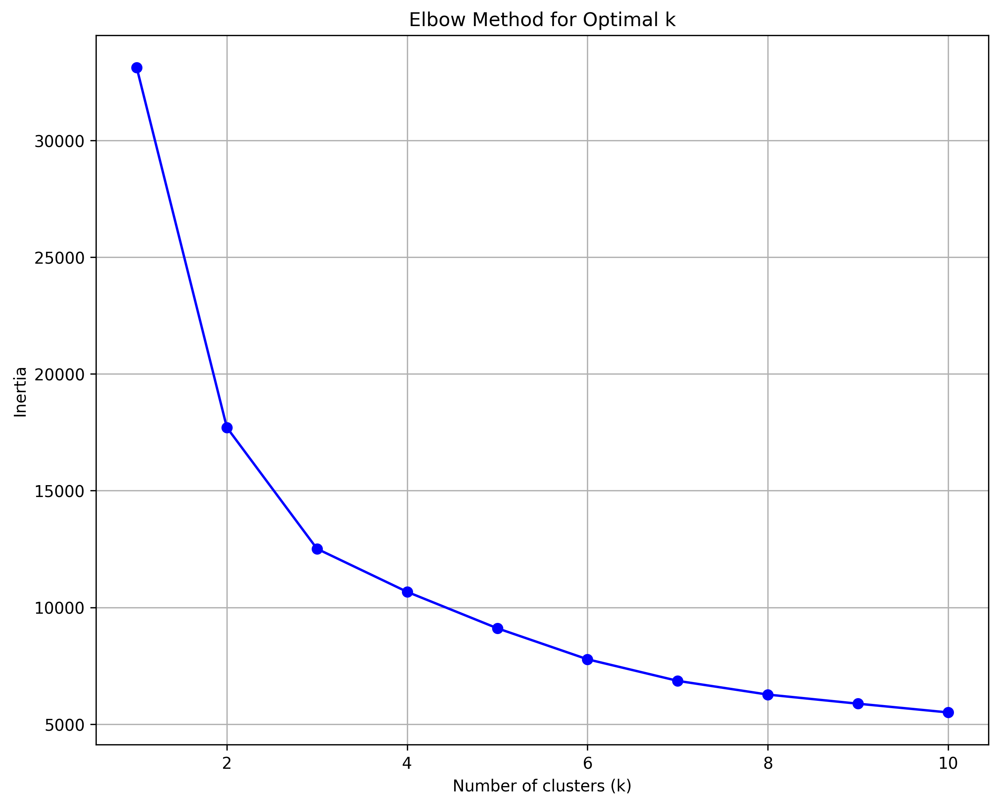

In [67]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

#inertia is defined based on the WCSS algoritmn. Means within cluster sum squares. dist between datapt and centroid. square and take sum
inertia = []
K = range(1, 11)

for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42).fit(X_scaled)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(10, 8), dpi=300)
plt.plot(K, inertia, 'bo-')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.grid(True)
plt.show()


In [68]:
!pip install umap-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 5.8 MB/s eta 0:00:00


In [78]:
#UMAP CODE w/ PLOTLY

import numpy as np
import pandas as pd
import plotly.graph_objs as go
import umap.umap_ as umap_module
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

umap_instance = umap_module.UMAP(n_components=3, random_state=42)

X_umap = umap_instance.fit_transform(X_scaled)

n_clusters = 3
kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10).fit(X_umap)
kmeans_labels = kmeans.labels_
kmeans_centers = kmeans.cluster_centers_

data_3d = pd.DataFrame(X_umap, columns=['x1', 'y1', 'z1'])
data_3d['Cluster'] = kmeans_labels

# use plotly again for the figures
fig = go.Figure()

for i in range(n_clusters):
    cluster_data = data_3d[data_3d['Cluster'] == i]
    fig.add_trace(go.Scatter3d(
        x=cluster_data['x1'],
        y=cluster_data['y1'],
        z=cluster_data['z1'],
        mode='markers',
        marker=dict(size=5),
        name=f'Cluster {i}'
    ))

fig.add_trace(go.Scatter3d(
    x=kmeans_centers[:, 0],
    y=kmeans_centers[:, 1],
    z=kmeans_centers[:, 2],
    mode='markers',
    marker=dict(size=10, color='red', symbol='x'),
    name='Centroids'
))

fig.update_layout(
    scene=dict(
        xaxis_title='x1',
        yaxis_title='y1',
        zaxis_title='z1'
    ),
    title='3D K-means Clustering with UMAP Reduction',
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [71]:
#RANDOM FOREST
from sklearn.model_selection import train_test_split
X_train_rf, X_test_rf, y_train_rf, y_test_rf = train_test_split(X_scaled, Y_filtered, test_size=0.33, random_state=42)

In [72]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(X_train_rf, y_train_rf)

RandomForestClassifier()

In [73]:
y_output = rf.predict(X_test_rf)

In [74]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from google.colab import files

correlation_arr = confusion_matrix(y_output, y_test_rf, normalize='true')

plt.figure(figsize=(10, 8), dpi=300)
ax = sns.heatmap(correlation_arr, annot=True, fmt=".2%", cmap='viridis')
ax.set_title('Confusion Matrix with Normalized Percentages')
ax.set_ylabel('Predicted Label')
ax.set_xlabel('True Label')

plt.savefig('confusion_matrix_high_res.png', dpi=300)
plt.close()

files.download('confusion_matrix_high_res.png')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

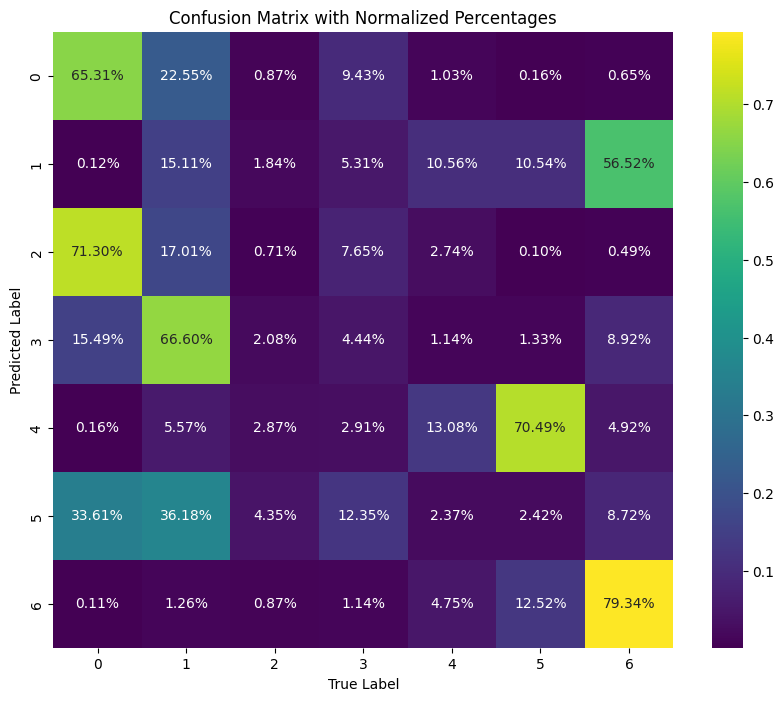

In [75]:
#K-MEANS Confusion MATRIX

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

correlation_arr = confusion_matrix(kmeans_labels, Y_filtered, normalize='true')

plt.figure(figsize=(10, 8))  # Adjust the size of the plot as needed
ax = sns.heatmap(correlation_arr, annot=True, fmt=".2%", cmap='viridis')
ax.set_title('Confusion Matrix with Normalized Percentages')
ax.set_ylabel('Predicted Label')
ax.set_xlabel('True Label')

plt.show()

In [76]:
label_to_cluster = np.stack((kmeans_labels, Y_filtered), axis = 1)

<Axes: >

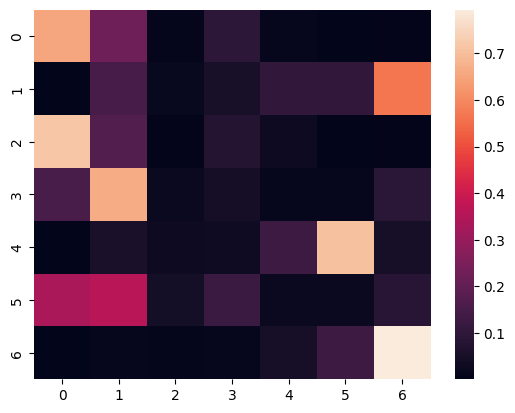

In [77]:
#HEAT MAP
from sklearn.metrics import confusion_matrix
correlation_arr = confusion_matrix(kmeans_labels, Y_filtered, normalize = 'true')
sns.heatmap(correlation_arr)